In [3]:
# Libarary

import pandas as pd
import time
import mysql.connector
import openpyxl
import json
import requests
import folium
import geopandas as gpd

import collections
import numpy as np
import pydeck
from IPython.display import display, clear_output


import matplotlib.pyplot as plt
plt.rc('font', family='NanumGothicOTF') # For MacOS


In [ ]:
# Function

def GetLatLon(addr):
    url = 'https://dapi.kakao.com/v2/local/search/address.json?query={address}'.format(address=addr)
    headers = {"Authorization": "KakaoAK 58319f62a30cce26d40b890be26fc6fd"}
    result = json.loads(str(requests.get(url, headers=headers).text))
    match_first = result['documents'][0]['address']
    return float(match_first['x']), float(match_first['y'])

def AddLatLon(data):

    address = data['ADDRESS']
    X = []
    Y = []
    for each in address:
        try:
            LatLon = GetLatLon(each)
            X.append(LatLon[1])
            Y.append(LatLon[0])
        except:
            X.append('')
            Y.append('')


    data['X'] = X
    data['Y'] = Y

    return data
 
def Get_Dong(keyword):
    try:
        url = 'https://dapi.kakao.com/v2/local/search/keyword.json?query={}'.format(keyword) # 키워드로 검색하는 URL 주소 요청
        headers = {'authorization': 'KakaoAK 58319f62a30cce26d40b890be26fc6fd'}
        # result = json.loads(str(requests.get(url, headers=headers).text))
        search_result_list = requests.get(url, headers = headers).json()['documents']
        search_result_1st = search_result_list[0]
        address_token = str(search_result_1st['address_name']).split(' ')
        for each_token in address_token:
            if each_token.endswith('동'):
                return each_token
            elif each_token.endswith('읍') or each_token.endswith('면'):
                return each_token

    except:
        print(f'이 검색어 [{keyword}] 는(은) 검색결과가 없습니다')
        return None

# 데이터프레임에 동 컬럼 전체적으로 추가할때 사용
def GetDataFrameWithDong(data, column_name):
    dt = []
    for idx , each_row in data.iterrows():
        keyword = each_row[column_name] #검색할 컬럼 
        dong = Get_Dong(keyword)
        final_list = each_row.tolist()
        final_list.append(dong)
        dt.append(final_list)
    df = pd.DataFrame(dt) 

    column_name = data.columns.to_list()
    column_name.append('NEW_DONG')
    df.columns = column_name
    return df


# 동 찾기
def Get_Add_Lat_Lon(keyword):
    try:
        url = 'https://dapi.kakao.com/v2/local/search/keyword.json?query={}'.format(keyword) # 키워드로 검색하는 URL 주소 요청
        headers = {'authorization': 'KakaoAK 58319f62a30cce26d40b890be26fc6fd'}
        # result = json.loads(str(requests.get(url, headers=headers).text))
        search_result_list = requests.get(url, headers = headers).json()['documents']
        search_result_1st = search_result_list[0]
        address = str(search_result_1st['road_address_name'])
        X = search_result_1st['y']
        Y = search_result_1st['x']
        list = [address , X, Y]
        return list
    except:
        print(f'{keyword} 검색 결과에는 주소, X, Y 를 찾을 수 없습니다')

def GetDataFrameWithAddLatLon(data, column_name):
    dt = []
    for idx , each_row in data.iterrows():
        keyword = each_row[column_name] #검색할 컬럼 
        Add_Lat_Lon = Get_Add_Lat_Lon(keyword)
        dong = Get_Dong(keyword)
        final_list = each_row.tolist()
        final_list.append(Add_Lat_Lon[0])
        final_list.append(dong)
        final_list.append(Add_Lat_Lon[1])
        final_list.append(Add_Lat_Lon[2])

        dt.append(final_list)
    df = pd.DataFrame(dt) 

    column_name = data.columns.to_list()
    column_name.append('ADDRESS')
    column_name.append('DONG')
    column_name.append('X')
    column_name.append('Y')
    df.columns = column_name
    return df

def SeoulDongMap(df):    
    path_dong = '/Users/sunwoongkim/dev/emd.json'
    path_gu = '/Users/sunwoongkim/dev/sig.json'

    df_gu= gpd.read_file(path_gu)
    df_dong= gpd.read_file(path_dong)

    result_df = pd.merge(df_gu, df_dong, left_on=df_gu['SIG_CD'], right_on=df_dong['EMD_CD'].str[:5], how='left')

    gu_list = df['GU'].unique().tolist()    

    gdf_test = result_df[result_df['SIG_KOR_NM'].isin(gu_list)].reset_index(drop=True)

    seoul_dong_map = folium.Map(location=(37.51434733724219, 127.07303593988632), tiles="OpenStreetMap", zoom_start=12)

    colors = [
        "darkred", "darkblue", "darkgreen", "darkpurple", "black", "gray", "navy", "midnightblue",
        "maroon", "indigo", "slategray", "dimgray", "darkslategray", "olive", "brown", "chocolate",
        "darkolivegreen", "teal", "saddlebrown", "darkmagenta", "darkorchid", "darkgoldenrod", 
        "darkcyan", "darkkhaki", "firebrick"
    ]

    layer_dict = {}

    for idx, row in gdf_test.iterrows():
        
        gu_name = row['SIG_KOR_NM']
        dong_name = row['EMD_KOR_NM']
        polygon_wkt = row['geometry_y']
        
        if gu_name in layer_dict:
            layer = layer_dict[gu_name]
        else:
            layer = folium.FeatureGroup(name=gu_name,show=True)
            layer_dict[gu_name] = layer
            layer.add_to(seoul_dong_map)
        
        color = colors[len(layer_dict) % len(colors)]
        
        t1 = folium.GeoJson(polygon_wkt, 
                        style_function=lambda feature, color=color: {
                            'fillColor': color,
                            'fillOpacity': 0.3, 
                            'color': color, 
                            'weight': 1, 
                            'opacity': 1  
                        },
                        tooltip=f'법정동: {dong_name}')
        
        t1.add_to(layer)

    for idx, row  in df.iterrows():
        folium.Marker((row['X'], row['Y']),
        tooltip=(row['NAME'], row['FOUNDDATE']),
        icon=folium.Icon(icon= 'star', color = 'blue'),
        ).add_to(seoul_dong_map)

    folium.LayerControl(collapsed=False).add_to(seoul_dong_map)
    folium.LatLngPopup().add_to(seoul_dong_map)
    display(seoul_dong_map)

## [데이터 불러오기] 

### -> 2014~2022 대학교 학과별 모집인원

#### 1. csv 다운로드 파일 볼러오기

In [ ]:
df = pd.read_csv('/Users//dev/01 2014-2022년 대학별 학과별 모집인원_최종.csv', encoding= 'cp949')

#### 2. Column 영어로 변경

In [ ]:
df.columns = ['Year', 'SchoolType','Name','Campus','Class1', 'Class2','Class3', 'Major','Capacity']

df.to_csv('/Users//dev/uni_by_major.csv')

#### 3. DBMS에 저장

In [ ]:
# DBMS에 연결
projectdb = mysql.connector.connect(
    host="",
    user="master",
    password="",
    database="edaproject"
)
cursor = projectdb.cursor()

sql_insert_query = """
INSERT INTO UNIVERSITY_INFO (YEAR, SCHOOLTYPE,NAME,CAMPUS,CLASS1, CLASS2,CLASS3, MAJOR,CAPACITY)
VALUES (%s, %s, %s, %s, %s, %s, %s, %s, %s)
"""

for index , row in df.iterrows():
    each_list = list(row)

    cursor.execute(sql_insert_query, each_list)
    projectdb.commit()

TypeError: 'list' object is not callable

### -> 전국 국영수 학원 데이터

#### 1. 다운로드 파일 불러오기

In [64]:
private_edu_kor = pd.read_csv('/Users/sunwoongkim/dev/국어학원.csv', index_col= 0)
private_edu_eng = pd.read_csv('/Users/sunwoongkim/dev/영어학원.csv',index_col= 0)
private_edu_math = pd.read_csv('/Users/sunwoongkim/dev/수학학원.csv',index_col= 0)

#### 2. DBMS에 넣기

In [ ]:
projectdb = mysql.connector.connect(
    host="",
    user="master",
    password="",
    database="edaproject"
)


cursor = projectdb.cursor()

sql_insert_query = """
INSERT INTO PRIVATE_EDU_MATH (ID, NAME ,X,Y,ADDRESS)
VALUES (%s, %s, %s, %s, %s)
"""

for index , row in private_edu_math.iterrows():
    each_list = list(row[:-1])
    try:
        cursor.execute(sql_insert_query, each_list)
        projectdb.commit()
    except:
        continue


### -> 사교육 통계자료 

#### 1. 파일 불러오기

In [ ]:
private_edu_stat = pd.read_excel('/Users//dev/private_edu_stat.xlsx',header= [2,3])

# 필요없는 Row 제거
private_edu_stat = private_edu_stat.iloc[:-2]


#### 2. 학급별 통계만 뽑아내기

In [6]:
all_rate = private_edu_stat.iloc[:, 1]
all_hour =  private_edu_stat.iloc[:, 2]
prim_rate = private_edu_stat.iloc[:, 3]
prim_hour =  private_edu_stat.iloc[:, 4]
midd_rate = private_edu_stat.iloc[:, 5]
midd_hour = private_edu_stat.iloc[:, 6]
high_rate = private_edu_stat.iloc[:, 7]
high_hour = private_edu_stat.iloc[:, 8]


list = [all_rate, all_hour , prim_rate, prim_hour, midd_rate,midd_hour,high_rate,high_hour]
 

def NormalizeTable(rate_list , hour_list ):
    final_list = []
    for each_prim_rate , each_prim_hour in zip (rate_list, hour_list):
        list = []
        list.append('초등학교')
        list.append(each_prim_rate)
        list.append(each_prim_hour)
        final_list.append(list)
    return final_list

all_df = NormalizeTable(all_rate, all_hour)
prim_df = NormalizeTable(prim_rate, prim_hour)
midd_df = NormalizeTable(midd_rate, midd_hour)
high_df = NormalizeTable(high_rate, high_hour)


## [동 추가 작업]

#### MySQL [UNIVERSITY_INFO] 주소/동/X/Y 추가

In [201]:
query = '''
SELECT * 
FROM edaproject.UNIVERSITY_INFO
group by NAME
'''
uni_list = pd.read_sql(query, projectdb)


# 동 찾기
def Get_Add_Lat_Lon(keyword):
    try:
        url = 'https://dapi.kakao.com/v2/local/search/keyword.json?query={}'.format(keyword) # 키워드로 검색하는 URL 주소 요청
        headers = {'authorization': 'KakaoAK 58319f62a30cce26d40b890be26fc6fd'}
        # result = json.loads(str(requests.get(url, headers=headers).text))
        search_result_list = requests.get(url, headers = headers).json()['documents']
        search_result_1st = search_result_list[0]
        address = str(search_result_1st['road_address_name'])
        X = search_result_1st['y']
        Y = search_result_1st['x']
        list = [address , X, Y]
        return list
    except:
        print(f'{keyword} 검색 결과에는 주소, X, Y 를 찾을 수 없습니다')

def GetDataFrameWithAddLatLon(data, column_name):
    dt = []
    for idx , each_row in data.iterrows():
        keyword = each_row[column_name] #검색할 컬럼 
        Add_Lat_Lon = Get_Add_Lat_Lon(keyword)
        dong = Get_Dong(keyword)
        final_list = each_row.tolist()
        final_list.append(Add_Lat_Lon[0])
        final_list.append(dong)
        final_list.append(Add_Lat_Lon[1])
        final_list.append(Add_Lat_Lon[2])

        dt.append(final_list)
    df = pd.DataFrame(dt) 

    column_name = data.columns.to_list()
    column_name.append('ADDRESS')
    column_name.append('DONG')
    column_name.append('X')
    column_name.append('Y')
    df.columns = column_name
    return df

df = GetDataFrameWithAddLatLon(uni_list, 'NAME')


/var/folders/79/m8mlq40133v66kkf7xw8f89c0000gn/T/ipykernel_65314/3345637113.py:6: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  uni_list = pd.read_sql(query, projectdb)


#### MySQL [metro_2010] 동 추가

In [ ]:
metro_2010 = pd.read_csv('/Users//dev/metro_2010.csv', index_col=0)

metro_2010_with_dong = []
for idx , each_row in metro_2010.iterrows():
    keyword = each_row['STATION_NAME'].split('(')[0] + '역'
    dong = Get_Dong(keyword)
    final_list = each_row.tolist()
    final_list.append(dong)
    metro_2010_with_dong.append(final_list)

metro_2010_with_dong = pd.DataFrame(metro_2010_with_dong)
column_name = metro_2010.columns.to_list()
column_name.append('NEW_DONG')
metro_2010_with_dong.columns = column_name

#### MySQL [SCHOOL_INFO] 2014년이후 동 추가

In [203]:
query = '''
SELECT *
FROM edaproject.SCHOOL_INFO
where SIDO LIKE '%서울%' and  FOUNDDATE > '2014-01-01'
'''
SCHOOL_INFO = pd.read_sql(query, projectdb)

SCHOOL_INFO_WITH_DONG =  GetDataFrameWithDong(SCHOOL_INFO, 'NAME')



/var/folders/79/m8mlq40133v66kkf7xw8f89c0000gn/T/ipykernel_65314/2504134681.py:6: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  SCHOOL_INFO = pd.read_sql(query, projectdb)


In [ ]:
dong_list_2014 = list(school_after_2014_2014['DONG'].unique())
dong_list_2015 = list(school_after_2014_2015['DONG'].unique())
dong_list_2016 = list(school_after_2014_2016['DONG'].unique())
dong_list_2017 = list(school_after_2014_2017['DONG'].unique())
dong_list_2018 = list(school_after_2014_2018['DONG'].unique())
dong_list_2019 = list(school_after_2014_2019['DONG'].unique())
dong_list_2020 = list(school_after_2014_2020['DONG'].unique())
dong_list_2021 = list(school_after_2014_2021['DONG'].unique())
dong_list_2022 = list(school_after_2014_2022['DONG'].unique())
dong_list_2023 = list(school_after_2014_2023['DONG'].unique())
dong_list_2024 = list(school_after_2014_2024['DONG'].unique())

dong_list_2014

dong_list_2014_with_price = price_change_rate_by_DONG[price_change_rate_by_DONG['DONG'].isin(dong_list_2014)]
dong_list_2014_with_price_YEAR =  dong_list_2014_with_price[dong_list_2014_with_price['YEAR'] == 2014]

dong_list_2015_with_price = price_change_rate_by_DONG[price_change_rate_by_DONG['DONG'].isin(dong_list_2015)]
dong_list_2015_with_price_YEAR =  dong_list_2015_with_price[dong_list_2015_with_price['YEAR'] == 2015]

dong_list_2016_with_price = price_change_rate_by_DONG[price_change_rate_by_DONG['DONG'].isin(dong_list_2016)]
dong_list_2016_with_price_YEAR =  dong_list_2016_with_price[dong_list_2016_with_price['YEAR'] == 2016]

dong_list_2017_with_price = price_change_rate_by_DONG[price_change_rate_by_DONG['DONG'].isin(dong_list_2017)]
dong_list_2017_with_price_YEAR =  dong_list_2017_with_price[dong_list_2017_with_price['YEAR'] == 2017]

dong_list_2018_with_price = price_change_rate_by_DONG[price_change_rate_by_DONG['DONG'].isin(dong_list_2018)]
dong_list_2018_with_price_YEAR =  dong_list_2018_with_price[dong_list_2018_with_price['YEAR'] == 2018]

dong_list_2019_with_price = price_change_rate_by_DONG[price_change_rate_by_DONG['DONG'].isin(dong_list_2019)]
dong_list_2019_with_price_YEAR =  dong_list_2019_with_price[dong_list_2019_with_price['YEAR'] == 2019]

dong_list_2020_with_price = price_change_rate_by_DONG[price_change_rate_by_DONG['DONG'].isin(dong_list_2020)]
dong_list_2020_with_price_YEAR =  dong_list_2020_with_price[dong_list_2020_with_price['YEAR'] == 2020]

dong_list_2021_with_price = price_change_rate_by_DONG[price_change_rate_by_DONG['DONG'].isin(dong_list_2021)]
dong_list_2021_with_price_YEAR =  dong_list_2021_with_price[dong_list_2021_with_price['YEAR'] == 2021]

dong_list_2022_with_price = price_change_rate_by_DONG[price_change_rate_by_DONG['DONG'].isin(dong_list_2022)]
dong_list_2022_with_price_YEAR =  dong_list_2022_with_price[dong_list_2022_with_price['YEAR'] == 2022]

dong_list_2023_with_price = price_change_rate_by_DONG[price_change_rate_by_DONG['DONG'].isin(dong_list_2023)]
dong_list_2023_with_price_YEAR =  dong_list_2023_with_price[dong_list_2023_with_price['YEAR'] == 2023]

dong_list_2024_with_price = price_change_rate_by_DONG[price_change_rate_by_DONG['DONG'].isin(dong_list_2024)]
dong_list_2024_with_price_YEAR =  dong_list_2024_with_price[dong_list_2024_with_price['YEAR'] == 2024]


#### MySQL [PUBLIC_SECTOR] 동 추가

In [204]:
query = '''
SELECT * FROM edaproject.PUBLIC_SECTOR;
'''
PUBLIC_SECTOR = pd.read_sql(query, projectdb)

PUBLIC_SECTOR_WITH_DONG = GetDataFrameWithDong(PUBLIC_SECTOR, 'NAME')

/var/folders/79/m8mlq40133v66kkf7xw8f89c0000gn/T/ipykernel_65314/2349600196.py:4: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  PUBLIC_SECTOR = pd.read_sql(query, projectdb)


이 검색어 [(재)APEC기후센터] 는(은) 검색결과가 없습니다
이 검색어 [(재)예술경영지원센터] 는(은) 검색결과가 없습니다
이 검색어 [(재)우체국물류지원단] 는(은) 검색결과가 없습니다
이 검색어 [(재)일제강제동원피해자지원재단] 는(은) 검색결과가 없습니다
이 검색어 [(재)축산환경관리원] 는(은) 검색결과가 없습니다
이 검색어 [(재)한국보건의료정보원] 는(은) 검색결과가 없습니다
이 검색어 [(재)한국우편사업진흥원] 는(은) 검색결과가 없습니다
이 검색어 [(재)한국통계정보원] 는(은) 검색결과가 없습니다
이 검색어 [재단법인 국악방송] 는(은) 검색결과가 없습니다
이 검색어 [재단법인 대한건설기계안전관리원] 는(은) 검색결과가 없습니다
이 검색어 [재단법인 장애인기업종합지원센터] 는(은) 검색결과가 없습니다
이 검색어 [재단법인 한국에너지재단] 는(은) 검색결과가 없습니다
이 검색어 [재단법인 한국자활복지개발원] 는(은) 검색결과가 없습니다
이 검색어 [재단법인 한국장기조직기증원] 는(은) 검색결과가 없습니다


## [기본 시각화]

### 서울시 동 지도

In [ ]:
path_dong = '/Users//dev/emd.json'
path_gu = '/Users//dev/sig.json'

df_gu= gpd.read_file(path_gu)
df_dong= gpd.read_file(path_dong)

result_df = pd.merge(df_gu, df_dong, left_on=df_gu['SIG_CD'], right_on=df_dong['EMD_CD'].str[:5], how='left')

gdf_test = result_df[result_df['SIG_KOR_NM'].isin([
    "종로구", "중구", "용산구", "성동구", "광진구", "동대문구", "중랑구", "성북구", "강북구", "도봉구",
    "노원구", "은평구", "서대문구", "마포구", "양천구", "강서구", "구로구", "금천구", "영등포구", "동작구",
    "관악구", "서초구", "강남구", "송파구", "강동구"
])].reset_index(drop=True)

seoul_dong_map = folium.Map(location=(37.51434733724219, 127.07303593988632), tiles="OpenStreetMap", zoom_start=12)

colors = [
    "darkred", "darkblue", "darkgreen", "darkpurple", "black", "gray", "navy", "midnightblue",
    "maroon", "indigo", "slategray", "dimgray", "darkslategray", "olive", "brown", "chocolate",
    "darkolivegreen", "teal", "saddlebrown", "darkmagenta", "darkorchid", "darkgoldenrod", 
    "darkcyan", "darkkhaki", "firebrick"
]

layer_dict = {}

for idx, row in gdf_test.iterrows():
    
    gu_name = row['SIG_KOR_NM']
    dong_name = row['EMD_KOR_NM']
    polygon_wkt = row['geometry_y']
    
    if gu_name in layer_dict:
        layer = layer_dict[gu_name]
    else:
        layer = folium.FeatureGroup(name=gu_name,show=True)
        layer_dict[gu_name] = layer
        layer.add_to(seoul_dong_map)
    
    color = colors[len(layer_dict) % len(colors)]
    
    t1 = folium.GeoJson(polygon_wkt, 
                       style_function=lambda feature, color=color: {
                           'fillColor': color, 
                           'fillOpacity': 0.3,
                           'color': color, 
                           'weight': 1,
                           'opacity': 1 
                       },
                       tooltip=f'법정동: {dong_name}')
    
    t1.add_to(layer)
    
folium.LayerControl(collapsed=False).add_to(seoul_dong_map)
folium.LatLngPopup().add_to(seoul_dong_map)
display(seoul_dong_map)

### 전국 초중고 전체

In [206]:
query = '''
SELECT * FROM edaproject.SCHOOL_INFO
where TOTAL_STUDENTS != 0
'''
school_ = pd.read_sql(query, projectdb)

school_ = AddLatLon(school_)
school_ = school_[school_['X'] != '']

from folium import Marker
from folium.plugins import MarkerCluster

m = folium.Map(location=[37.58, 127.0], tiles='openstreetmap', zoom_start=11)

mc = MarkerCluster()
for _, row in school_.iterrows():
    mc.add_child(    
        Marker(location = [row['X'], row['Y']],
               popup=row['NAME']
              )
    )

m.add_child(mc)

m

/var/folders/79/m8mlq40133v66kkf7xw8f89c0000gn/T/ipykernel_65314/2468226356.py:5: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  school_ = pd.read_sql(query, projectdb)


### 서울 초중고 전체

In [207]:
query = '''
SELECT * FROM edaproject.SCHOOL_INFO
where SIDO LIKE '%서울%' and TOTAL_STUDENTS != 0
'''
school_ = pd.read_sql(query, projectdb)

school_ = AddLatLon(school_)
school_ = school_[school_['X'] != '']

from folium import Marker
from folium.plugins import MarkerCluster

m = folium.Map(location=[37.58, 127.0], tiles='openstreetmap', zoom_start=11)

mc = MarkerCluster()
for _, row in school_.iterrows():
    mc.add_child(    
        Marker(location = [row['X'], row['Y']],
               popup=row['NAME']
              )
    )

m.add_child(mc)

m

/var/folders/79/m8mlq40133v66kkf7xw8f89c0000gn/T/ipykernel_65314/583066480.py:5: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  school_ = pd.read_sql(query, projectdb)


### 서울시 구별 2014년 ~ 2024년

In [52]:
# 데이터

query = '''
SELECT *
FROM edaproject.SCHOOL_INFO
where SIDO LIKE '%서울%' and FOUNDDATE > '2014-01-01'
'''
school_after_2014 = pd.read_sql(query, projectdb)

school_after_2014 = GetDataFrameWithAddLatLon(school_after_2014, 'NAME')


/var/folders/79/m8mlq40133v66kkf7xw8f89c0000gn/T/ipykernel_85394/3568943100.py:8: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  school_after_2014 = pd.read_sql(query, projectdb)


#### 동별 학교 위치

In [11]:
SeoulDongMap(school_after_2014)

#### 누적 설립 학교 동적 시각화

In [62]:
# 연도별로 각각 저장
time.sleep(10)
for year in range(2014, 2025):
    globals()[f"school_after_2014_{year}"] = school_after_2014[
        (school_after_2014['FOUNDDATE'] > f'{year}-01-01') & (school_after_2014['FOUNDDATE'] < f'{year}-12-31')
    ]

# 지도
m = folium.Map(location=[37.51161181809386,126.98442514704972],
               zoom_start=11
               )

# 누적 학교 시각화
def StackedSchoolMap(year):
    title_html = f'''
                <h3 align="center" style="font-size:20px"><b>2014년 ~ 2024년 설립 학교 (현재: {year}년)</b></h3>
                '''
    m.get_root().html.add_child(folium.Element(title_html))
    for i in range(2014, year+1):
        variable_name = f'school_after_2014_{i}'
        df = globals()[variable_name]

        if i == year:
            for idx, row  in df.iterrows():
                folium.Marker((row['X'], row['Y']),
                tooltip=(row['NAME'], row['ADDRESS']),
                icon=folium.Icon( prefix='fa',color = 'blue'),
                ).add_to(m)
        else:
            for idx, row  in df.iterrows():
                folium.Marker((row['X'], row['Y']),
                tooltip=(row['NAME'], row['ADDRESS']),
                icon=folium.Icon(prefix='fa',color = 'gray'),
                ).add_to(m)
    return m

# 연도별 연결 시각화
for each_year in range(2014,2025):
    m = StackedSchoolMap(each_year)
    clear_output(wait=True)
    display(m)
    time.sleep(2.5)


## [통계 분석]

사용할 Table

DONG_PRICE
SCHOOL_INFO

#### 기간별 설립 학교 동 누적 가격 변동률

In [46]:
query = '''
WITH YearlyPrices AS (
    SELECT
		GU,
        DONG,
        YEAR,
        AVG(PRICE) AS AvgPrice
    FROM 
        DONG_PRICE
    GROUP BY 
        GU, DONG, YEAR
),
PriceChange AS (
    SELECT 
		a.GU,
        a.DONG,
        a.YEAR,
        a.AvgPrice AS CurrentPrice,
        COALESCE(b.AvgPrice, 0) AS PreviousPrice,
        CASE 
            WHEN COALESCE(b.AvgPrice, 0) = 0 THEN 0
            ELSE (a.AvgPrice - b.AvgPrice) * 100.0 / b.AvgPrice
        END AS PriceChangeRate
    FROM 
        YearlyPrices a
    LEFT JOIN 
        YearlyPrices b ON a.DONG = b.DONG AND a.YEAR = b.YEAR + 1
)
SELECT
	GU,
    DONG,
    YEAR,
    CurrentPrice,
    PreviousPrice,
    PriceChangeRate
FROM 
    PriceChange
ORDER BY 
    GU,DONG, YEAR;

'''

price_change_rate_by_DONG  = pd.read_sql(query, projectdb)

query = '''
SELECT *
FROM edaproject.SCHOOL_INFO
where SIDO LIKE '%서울%' and FOUNDDATE > '2014-01-01'
'''

school_after_2014 = pd.read_sql(query, projectdb)
school_after_2014 = GetDataFrameWithDong(school_after_2014, 'NAME')

school_after_2014_2014 = school_after_2014[school_after_2014['FOUNDDATE'].dt.year == 2014]
school_after_2014_2015 = school_after_2014[school_after_2014['FOUNDDATE'].dt.year == 2015]
school_after_2014_2016 = school_after_2014[school_after_2014['FOUNDDATE'].dt.year == 2016]
school_after_2014_2017 = school_after_2014[school_after_2014['FOUNDDATE'].dt.year == 2017]
school_after_2014_2018 = school_after_2014[school_after_2014['FOUNDDATE'].dt.year == 2018]
school_after_2014_2019 = school_after_2014[school_after_2014['FOUNDDATE'].dt.year == 2019]
school_after_2014_2020 = school_after_2014[school_after_2014['FOUNDDATE'].dt.year == 2020]
school_after_2014_2021 = school_after_2014[school_after_2014['FOUNDDATE'].dt.year == 2021]
school_after_2014_2022 = school_after_2014[school_after_2014['FOUNDDATE'].dt.year == 2022]
school_after_2014_2023 = school_after_2014[school_after_2014['FOUNDDATE'].dt.year == 2023]
school_after_2014_2024 = school_after_2014[school_after_2014['FOUNDDATE'].dt.year == 2024]

dong_list_2014 = list(school_after_2014_2014['NEW_DONG'].unique())
dong_list_2015 = list(school_after_2014_2015['NEW_DONG'].unique())
dong_list_2016 = list(school_after_2014_2016['NEW_DONG'].unique())
dong_list_2017 = list(school_after_2014_2017['NEW_DONG'].unique())
dong_list_2018 = list(school_after_2014_2018['NEW_DONG'].unique())
dong_list_2019 = list(school_after_2014_2019['NEW_DONG'].unique())
dong_list_2020 = list(school_after_2014_2020['NEW_DONG'].unique())
dong_list_2021 = list(school_after_2014_2021['NEW_DONG'].unique())
dong_list_2022 = list(school_after_2014_2022['NEW_DONG'].unique())
dong_list_2023 = list(school_after_2014_2023['NEW_DONG'].unique())
dong_list_2024 = list(school_after_2014_2024['NEW_DONG'].unique())

dong_list_2014

dong_list_2014_with_price = price_change_rate_by_DONG[price_change_rate_by_DONG['DONG'].isin(dong_list_2014)]
dong_list_2014_with_price_YEAR =  dong_list_2014_with_price[dong_list_2014_with_price['YEAR'] == 2014]

dong_list_2015_with_price = price_change_rate_by_DONG[price_change_rate_by_DONG['DONG'].isin(dong_list_2015)]
dong_list_2015_with_price_YEAR =  dong_list_2015_with_price[dong_list_2015_with_price['YEAR'] == 2015]

dong_list_2016_with_price = price_change_rate_by_DONG[price_change_rate_by_DONG['DONG'].isin(dong_list_2016)]
dong_list_2016_with_price_YEAR =  dong_list_2016_with_price[dong_list_2016_with_price['YEAR'] == 2016]

dong_list_2017_with_price = price_change_rate_by_DONG[price_change_rate_by_DONG['DONG'].isin(dong_list_2017)]
dong_list_2017_with_price_YEAR =  dong_list_2017_with_price[dong_list_2017_with_price['YEAR'] == 2017]

dong_list_2018_with_price = price_change_rate_by_DONG[price_change_rate_by_DONG['DONG'].isin(dong_list_2018)]
dong_list_2018_with_price_YEAR =  dong_list_2018_with_price[dong_list_2018_with_price['YEAR'] == 2018]

dong_list_2019_with_price = price_change_rate_by_DONG[price_change_rate_by_DONG['DONG'].isin(dong_list_2019)]
dong_list_2019_with_price_YEAR =  dong_list_2019_with_price[dong_list_2019_with_price['YEAR'] == 2019]

dong_list_2020_with_price = price_change_rate_by_DONG[price_change_rate_by_DONG['DONG'].isin(dong_list_2020)]
dong_list_2020_with_price_YEAR =  dong_list_2020_with_price[dong_list_2020_with_price['YEAR'] == 2020]

dong_list_2021_with_price = price_change_rate_by_DONG[price_change_rate_by_DONG['DONG'].isin(dong_list_2021)]
dong_list_2021_with_price_YEAR =  dong_list_2021_with_price[dong_list_2021_with_price['YEAR'] == 2021]

dong_list_2022_with_price = price_change_rate_by_DONG[price_change_rate_by_DONG['DONG'].isin(dong_list_2022)]
dong_list_2022_with_price_YEAR =  dong_list_2022_with_price[dong_list_2022_with_price['YEAR'] == 2022]

dong_list_2023_with_price = price_change_rate_by_DONG[price_change_rate_by_DONG['DONG'].isin(dong_list_2023)]
dong_list_2023_with_price_YEAR =  dong_list_2023_with_price[dong_list_2023_with_price['YEAR'] == 2023]

dong_list_2024_with_price = price_change_rate_by_DONG[price_change_rate_by_DONG['DONG'].isin(dong_list_2024)]
dong_list_2024_with_price_YEAR =  dong_list_2024_with_price[dong_list_2024_with_price['YEAR'] == 2024]


/var/folders/79/m8mlq40133v66kkf7xw8f89c0000gn/T/ipykernel_85394/2315807689.py:43: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  price_change_rate_by_DONG  = pd.read_sql(query, projectdb)
/var/folders/79/m8mlq40133v66kkf7xw8f89c0000gn/T/ipykernel_85394/2315807689.py:51: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  school_after_2014 = pd.read_sql(query, projectdb)


In [ ]:
time.sleep(10)
for i in range(2014, 2025):
    # Access the DataFrame for each year dynamically
    df = globals()[f'dong_list_{i}_with_price']
    df_pivot = df.pivot(index='DONG', columns='YEAR', values='PriceChangeRate')

    # Specify colors, highlighting the current year 'i'   
    colors = ['gray' if year != i else 'blue' for year in df_pivot.columns]
    try:
    # Plot the bar chart
        df_pivot.plot(kind="bar", figsize=(14, 7), width=0.6, color=colors)
    except:
        continue

    plt.title(f"Price Change Rate by DONG in {i}")
    plt.xlabel("DONG")
    plt.ylabel("Price Change Rate (%)")
    plt.legend(title="Year", bbox_to_anchor=(1, 1), loc='upper left')
    plt.tight_layout()
    
    clear_output(wait=True)
    plt.show()
    time.sleep(3)



#### 새로 설립된 학교 동 변화률 중 30 이상 동의 기간별 변화률

In [63]:
query = '''
WITH YearlyPrices AS (
    SELECT
		GU,
        DONG,
        YEAR,
        AVG(PRICE) AS AvgPrice
    FROM 
        DONG_PRICE
    GROUP BY 
        GU, DONG, YEAR
),
PriceChange AS (
    SELECT 
		a.GU,
        a.DONG,
        a.YEAR,
        a.AvgPrice AS CurrentPrice,
        COALESCE(b.AvgPrice, 0) AS PreviousPrice,
        CASE 
            WHEN COALESCE(b.AvgPrice, 0) = 0 THEN 0
            ELSE (a.AvgPrice - b.AvgPrice) * 100.0 / b.AvgPrice
        END AS PriceChangeRate
    FROM 
        YearlyPrices a
    LEFT JOIN 
        YearlyPrices b ON a.DONG = b.DONG AND a.YEAR = b.YEAR + 1
)
SELECT
	GU,
    DONG,
    YEAR,
    CurrentPrice,
    PreviousPrice,
    PriceChangeRate
FROM 
    PriceChange
ORDER BY 
    GU,DONG, YEAR;

'''

price_change_rate_by_DONG  = pd.read_sql(query, projectdb)

query = '''
SELECT *
FROM edaproject.SCHOOL_INFO
where SIDO LIKE '%서울%' and FOUNDDATE > '2014-01-01'
'''

school_after_2014 = pd.read_sql(query, projectdb)
school_after_2014 = GetDataFrameWithDong(school_after_2014, 'NAME')


/var/folders/79/m8mlq40133v66kkf7xw8f89c0000gn/T/ipykernel_85394/3189834007.py:43: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  price_change_rate_by_DONG  = pd.read_sql(query, projectdb)


OperationalError: MySQL Connection not available.

In [249]:
school_after_2014['FOUNDDATE'] = school_after_2014['FOUNDDATE'].dt.strftime('%Y')
school_after_2014['FOUNDDATE'] = school_after_2014['FOUNDDATE'].astype(int)

In [ ]:
# 해당 학교의 동과 가격 연결
merged_df = pd.merge(school_after_2014 , price_change_rate_by_DONG, how='left' , left_on= ['NEW_DONG', 'FOUNDDATE'], right_on= ['DONG', 'YEAR'])
merged_df = merged_df[['NAME','FOUNDDATE','NEW_DONG', 'DONG', 'YEAR', 'PriceChangeRate']]
merged_df = merged_df.sort_values('PriceChangeRate', ascending= False)

In [ ]:
# 변화률이 30 이상인 학교
merged_df_over_30 = merged_df[merged_df['PriceChangeRate'] > 20 ]

In [323]:
# 해당 학교 동 확인
more_than_30 = list(df['DONG'].unique())
# 해당 동 가격
price_df = price_change_rate_by_DONG[price_change_rate_by_DONG['DONG'].str.contains('상일동|강일동|성북동|남가좌동|신원동|하왕십리동')]
# 성북1동은 우선 제외
price_df = price_df[price_df['DONG'] != '성북동1가']

price_df = price_df[['DONG', 'YEAR', 'PriceChangeRate']]

In [199]:
df_pivot = price_df.pivot(index="DONG", columns="YEAR")


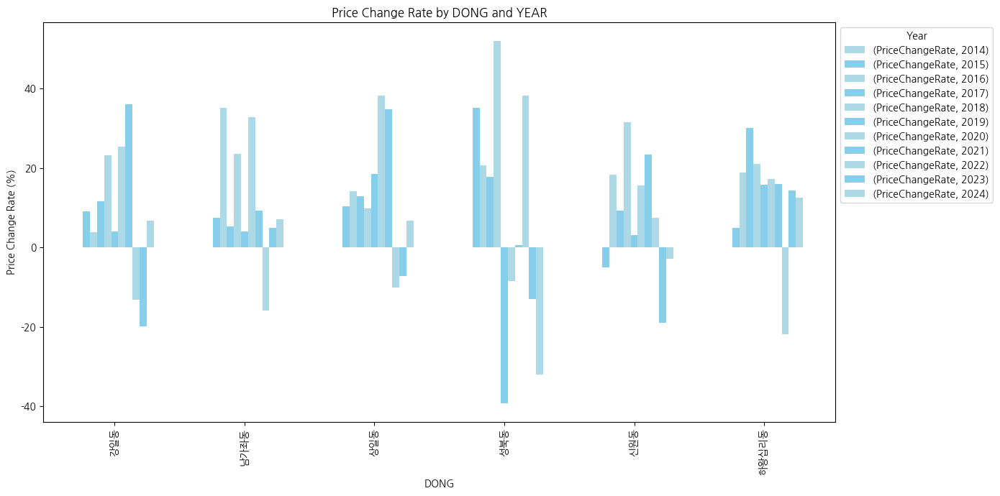

In [200]:
colors = ['lightblue', 'skyblue']

df_pivot.plot(kind="bar", figsize=(14, 7), width=0.6, color=colors)

plt.title("Price Change Rate by DONG and YEAR")
plt.xlabel("DONG")
plt.ylabel("Price Change Rate (%)")
plt.legend(title="Year", bbox_to_anchor=(1, 1), loc='upper left')
plt.tight_layout()

#### 새로 설립된 학교 동 변화률 중 30 이상 동의 기간별 변화률

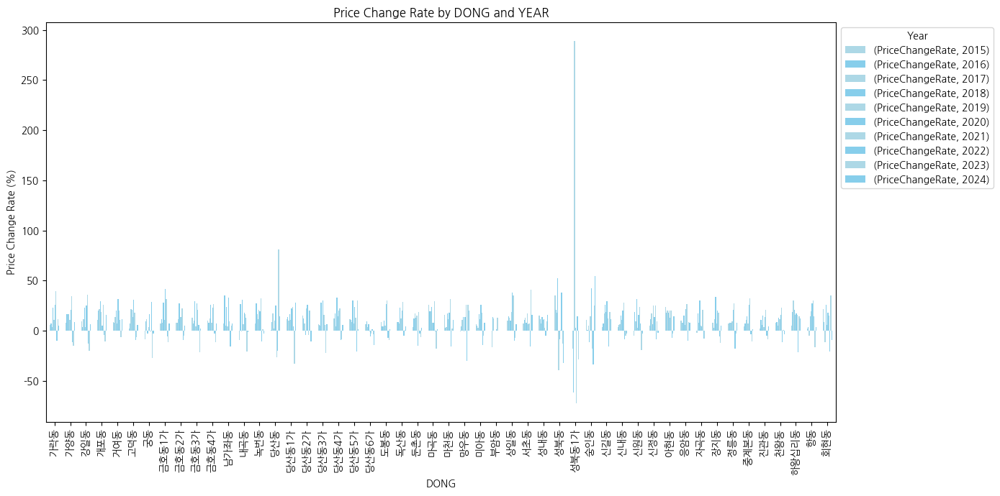

In [201]:
price_df = price_change_rate_by_DONG[['DONG', 'YEAR', 'PriceChangeRate']]

price_df = price_df[price_df["DONG"] != '전체']
price_df = price_df[price_df["YEAR"] != 2014]

price_df_pivot = price_df.pivot(index= 'DONG' , columns='YEAR')

price_df_pivot.plot(kind="bar", figsize=(14, 7), width=0.6, color=colors)

plt.title("Price Change Rate by DONG and YEAR")
plt.xlabel("DONG")
plt.ylabel("Price Change Rate (%)")
plt.legend(title="Year", bbox_to_anchor=(1, 1), loc='upper left')
plt.tight_layout()

In [214]:
price_change_rate_by_DONG = price_change_rate_by_DONG[price_change_rate_by_DONG['DONG'].str.contains('상일동|강일동|성북동|남가좌동|신원동|하왕십리동')]
price_change_rate_by_DONG = price_change_rate_by_DONG[price_change_rate_by_DONG['DONG'] != '성북동1가']


In [241]:
df = pd.merge(price_change_rate_by_DONG ,school_after_2014, how='left', left_on=['DONG','YEAR'], right_on= ['NEW_DONG','FOUNDDATE'])

In [242]:
df = df[['DONG', 'YEAR', 'PriceChangeRate', 'NAME']]

In [243]:
df

,DONG,YEAR,PriceChangeRate,NAME
0,강일동,2014,0.000000,NaN
1,강일동,2015,9.090287,NaN
2,강일동,2016,3.797948,NaN
3,강일동,2017,11.607091,서울강솔초등학교
4,강일동,2018,23.187487,NaN
...,...,...,...,...
61,성북동,2020,-8.486099,NaN
62,성북동,2021,0.583992,NaN
63,성북동,2022,38.319672,NaN
64,성북동,2023,-12.962963,NaN


In [226]:
df

,GU_x,DONG,YEAR,CurrentPrice,PreviousPrice,PriceChangeRate,ID,SIDO,GU_y,NAME,SCHOOLTYPE,SCHOOLLEVEL,FOUNDDATE,KESPA,MAIN_TEL,ADDRESS,TOTAL_STUDENTS,NEW_DONG
0,강동구,강일동,2014,4.159083e+08,0.000000e+00,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,강동구,강일동,2015,4.537156e+08,4.159083e+08,9.090287,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,강동구,강일동,2016,4.709475e+08,4.537156e+08,3.797948,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,강동구,강일동,2017,5.256108e+08,4.709475e+08,11.607091,e6a7034031,서울특별시,강동구,서울강솔초등학교,공립,초,2017.0,서울특별시강동송파교육지원청,02-2147-5700,서울특별시 강동구 고덕로97길 80,556.0,강일동
4,강동구,강일동,2018,6.474867e+08,5.256108e+08,23.187487,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61,성북구,성북동,2020,1.940667e+08,2.120625e+08,-8.486099,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
62,성북구,성북동,2021,1.952000e+08,1.940667e+08,0.583992,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
63,성북구,성북동,2022,2.700000e+08,1.952000e+08,38.319672,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
64,성북구,성북동,2023,2.350000e+08,2.700000e+08,-12.962963,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [18]:
query = '''
WITH YearlyPrices AS (
    SELECT
		GU,
        DONG,
        YEAR,
        AVG(AVG_PRICE) AS AvgPrice
    FROM 
        SEOUL_DONG_PRICE_YEARLY
    GROUP BY 
        GU, DONG, YEAR
),
PriceChange AS (
    SELECT 
		a.GU,
        a.DONG,
        a.YEAR,
        a.AvgPrice AS CurrentPrice,
        COALESCE(b.AvgPrice, 0) AS PreviousPrice,
        CASE 
            WHEN COALESCE(b.AvgPrice, 0) = 0 THEN 0
            ELSE (a.AvgPrice - b.AvgPrice) * 100.0 / b.AvgPrice
        END AS PriceChangeRate
    FROM 
        YearlyPrices a
    LEFT JOIN 
        YearlyPrices b ON a.DONG = b.DONG AND a.YEAR = b.YEAR + 1
)
SELECT
	GU,
    DONG,
    YEAR,
    CurrentPrice,
    PreviousPrice,
    PriceChangeRate
FROM 
    PriceChange
ORDER BY 
    GU,DONG, YEAR;

'''

price_change_rate_by_DONG  = pd.read_sql(query, projectdb)

/var/folders/79/m8mlq40133v66kkf7xw8f89c0000gn/T/ipykernel_85394/85901107.py:43: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  price_change_rate_by_DONG  = pd.read_sql(query, projectdb)


In [33]:
[price_change_rate_by_DONG['DONG'] == '충신동']

0       False
1       False
2       False
3       False
4       False
        ...  
3479    False
3480    False
3481    False
3482    False
3483    False
Name: DONG, Length: 3484, dtype: bool